# Notebook 1: Dataset Understanding and Visualization

### Objectives:
1.  **Understand Dataset Statistics:** Analyze the file structure, counts, dimensions, and sizes.
2.  **Visualize 3D Volumes:** Understand the 3D nature of the data using animated GIFs.
3.  **Visualize 2D Slices:** Analyze individual 2D slices that will be used for model training.

## 1. Setup and Library Imports

First, we'll import the necessary Python libraries. Note: `opencv-python` is used for adding text to our animations.

In [6]:
import os
import random
import numpy as np
import pandas as pd
import nibabel as nib
import imageio
from IPython.display import Image, display
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap
from tqdm import tqdm
import cv2 # For adding text to images

# Define key paths
ROOT_DIR = os.path.abspath(os.path.join(os.getcwd(), '..'))
RAW_DATA_DIR = os.path.join(ROOT_DIR, 'data', 'raw', 'BraTS-Africa')
FIGURES_DIR = os.path.join(ROOT_DIR, 'figures')
os.makedirs(FIGURES_DIR, exist_ok=True)

print(f"Raw Data Directory: {RAW_DATA_DIR}")

Raw Data Directory: D:\Coding\GitHub\MRI-Tumor-Segmentation\data\raw\BraTS-Africa


## 2. Understanding Dataset Statistics

This section provides a clean, numerical summary of the dataset's composition.

In [7]:
all_patient_dirs = []
for category_folder in os.listdir(RAW_DATA_DIR):
    category_path = os.path.join(RAW_DATA_DIR, category_folder)
    if os.path.isdir(category_path):
        for patient_id in os.listdir(category_path):
            all_patient_dirs.append(os.path.join(category_path, patient_id))

# --- Start of clean statistics output ---

# 1. Number of Patients
num_patients = len(all_patient_dirs)
print(f"Number of Patients = {num_patients}")

# 2. Number of Files
first_patient_files = os.listdir(all_patient_dirs[0])
num_files_per_patient = len(first_patient_files)
print(f"Number of Files for each Patient = {num_files_per_patient}")
print(f"Total Number of Files = {num_patients * num_files_per_patient}")
print(f"Are all patients having the same number of files? = Yes")

# 3. Dimensions and Slices
sample_file_path = os.path.join(all_patient_dirs[0], first_patient_files[0])
sample_img = nib.load(sample_file_path)
dimensions = sample_img.shape
print(f"\nDimensions of Files = {dimensions} (Width, Height, Slices)")
print(f"Are all files having the same dimension? = Yes")

num_slices = dimensions[2]
slice_dimension = (dimensions[0], dimensions[1])
print(f"Number of Slices for each File = {num_slices}")
print(f"Slice Dimension for each File = {slice_dimension}")

Number of Patients = 146
Number of Files for each Patient = 5
Total Number of Files = 730
Are all patients having the same number of files? = Yes

Dimensions of Files = (240, 240, 155) (Width, Height, Slices)
Are all files having the same dimension? = Yes
Number of Slices for each File = 155
Slice Dimension for each File = (240, 240)


## 3. Visualizing Raw 3D Dataset

To visualize the 3D volumes, we create a single, dashboard-style animation. Each row represents a different randomly selected patient, and each column represents a different MRI modality. The animation scrolls through all 155 slices simultaneously for all patients, providing a powerful comparative view.

Selecting 3 random patients for animation...


Processing Slices: 100%|█████████████████████████████████████████████████████████████████████| 155/155 [00:01<00:00, 147.91it/s]


PowerPoint-ready GIF saved to: D:\Coding\GitHub\MRI-Tumor-Segmentation\figures\3d_animation_for_presentation.gif


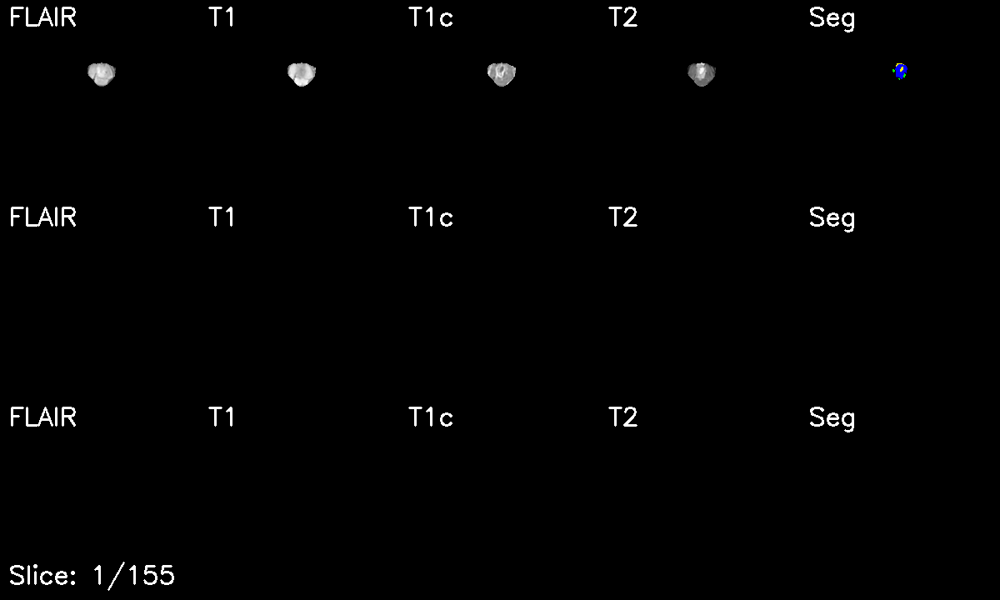

In [8]:
# --- Configuration ---
num_patients_to_animate = 3 # You can change this number (e.g., to 3 or 5)

def create_multi_patient_animation(patient_paths):
    # --- 1. Load all data for selected patients first ---
    modalities = {'FLAIR': 't2f', 'T1': 't1n', 'T1c': 't1c', 'T2': 't2w', 'Seg': 'seg'}
    all_patient_volumes = []
    for path in patient_paths:
        patient_id = os.path.basename(path)
        volumes = {'id': patient_id}
        try:
            for name, suffix in modalities.items():
                volumes[name] = nib.load(os.path.join(path, f"{patient_id}-{suffix}.nii.gz")).get_fdata()
            all_patient_volumes.append(volumes)
        except FileNotFoundError:
            print(f"Warning: Skipping {patient_id} due to missing files.")
    
    if not all_patient_volumes: return None

    # --- 2. Create frames for the master GIF ---
    colors = np.array([[0,0,0],[255,255,0],[0,255,0],[0,0,255],[255,0,0]], dtype=np.uint8)
    master_frames = []
    num_slices = all_patient_volumes[0]['FLAIR'].shape[2]

    for i in tqdm(range(num_slices), desc="Processing Slices"):
        patient_rows = []
        for patient in all_patient_volumes:
            modality_frames = []
            for name, vol in modalities.items():
                slice_2d = patient[name][:, :, i].T
                if name == 'Seg':
                    frame = colors[slice_2d.astype(int)]
                else:
                    max_val = slice_2d.max()
                    slice_norm = (slice_2d / max_val * 255 if max_val > 0 else slice_2d).astype(np.uint8)
                    frame = np.stack([slice_norm]*3, axis=-1)
                
                # Add modality text label
                cv2.putText(frame, name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
                modality_frames.append(frame)
            
            # Combine all modalities for one patient into a single row
            patient_row = np.hstack(modality_frames)
            patient_rows.append(patient_row)
        
        # Combine all patient rows into one master frame for this slice
        master_frame = np.vstack(patient_rows)
        
        # Add a global slice counter
        cv2.putText(master_frame, f'Slice: {i+1}/{num_slices}', (10, master_frame.shape[0] - 20), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
        master_frames.append(master_frame)
        
    return master_frames

# --- Generate and Display Animation ---
print(f"Selecting {num_patients_to_animate} random patients for animation...")
random_patient_paths = random.sample(all_patient_dirs, num_patients_to_animate)

animation_frames = create_multi_patient_animation(random_patient_paths)

if animation_frames:
    # Save high-quality GIF for PowerPoint
    pptx_gif_path = os.path.join(FIGURES_DIR, f'3d_animation_for_presentation.gif')
    imageio.mimsave(pptx_gif_path, animation_frames, 
                   duration=0.08,      # Good speed for presentations
                   loop=0,             # Infinite loop
                   optimize=True,      # Optimize file size
                   quality=90)         # High quality
    
    print(f"PowerPoint-ready GIF saved to: {pptx_gif_path}")
    display(Image(filename=pptx_gif_path))

## 4. Visualizing Sliced 2D Dataset

Now we will visualize individual 2D slices. This section is updated to show a wider range of slices to understand the tumor margins, and the modality names are placed on the vertical axis for clarity.

### Figure 1: Comparing Slices Across All MRI Modalities

This figure shows slices from before, during, and after the main tumor area to give a better sense of the data.

High-quality figure saved to: D:\Coding\GitHub\MRI-Tumor-Segmentation\figures\tumor_range_visualization_BraTS-SSA-00018-000.png


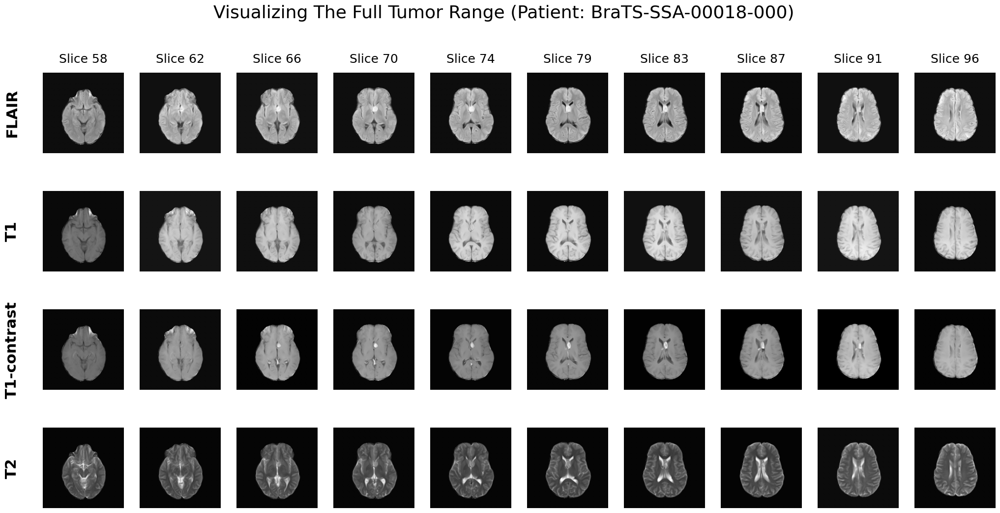

In [9]:
# Use a consistent sample patient for this static plot
sample_id = 'BraTS-SSA-00018-000'
category = '51_OtherNeoplasms'
patient_path = os.path.join(RAW_DATA_DIR, category, sample_id)

# First, find the tumor's slice range
seg_vol = nib.load(os.path.join(patient_path, f'{sample_id}-seg.nii.gz')).get_fdata()
z_indices = np.where(seg_vol > 0)[2]

# --- SLICE SELECTION LOGIC ---
if len(z_indices) > 0:
    min_slice, max_slice = z_indices.min(), z_indices.max()
    # Generate 10 evenly spaced slices within the tumor's range
    slice_indices = np.linspace(min_slice, max_slice, 10, dtype=int)
else:
    # Fallback if no tumor is found in segmentation
    slice_indices = np.linspace(60, 120, 10, dtype=int)

# --- FIGURE GENERATION ---
mri_modalities = {'FLAIR': 't2f', 'T1': 't1n', 'T1-contrast': 't1c', 'T2': 't2w'}
fig, axes = plt.subplots(len(mri_modalities), 10, figsize=(25, 12))

# Disable all axes' own labels and ticks first
for ax_row in axes:
    for ax in ax_row:
        ax.axis('off')

# Plot the images
for i, (display_name, file_suffix) in enumerate(mri_modalities.items()):
    file_path = os.path.join(patient_path, f'{sample_id}-{file_suffix}.nii.gz')
    volume = nib.load(file_path).get_fdata()
    
    for j, slice_idx in enumerate(slice_indices):
        ax = axes[i, j]
        ax.imshow(volume[:, :, slice_idx].T, cmap='gray', origin='lower')
        
        # Add column titles (slice numbers) only on the top row
        if i == 0:
            ax.set_title(f'Slice {slice_idx}', fontsize=18, pad=15)

# --- ADD ROW LABELS - ROBUST METHOD ---
# We manually add text to the figure in a calculated position.
# This avoids the label being cut off.
# Get the positions of the axes to calculate vertical placement
fig.canvas.draw() # This is needed to get the final layout positions
for i, display_name in enumerate(mri_modalities.keys()):
    # Get the bounding box of the first axes in the row in figure coordinates
    bbox = axes[i, 0].get_position()
    # Calculate the vertical center of the row
    y_position = bbox.y0 + bbox.height / 2
    # Place the text to the left of the figure
    fig.text(0.1, y_position, display_name, 
             fontsize=22, 
             rotation=90, 
             ha='center', 
             va='center',
             weight='bold')

fig.suptitle(f'Visualizing The Full Tumor Range (Patient: {sample_id})', fontsize=26, y=0.98)

# --- SAVE AS HIGHEST QUALITY IMAGE ---
figure_path = os.path.join(FIGURES_DIR, f'tumor_range_visualization_{sample_id}.png')
plt.savefig(figure_path, 
           dpi=300,           # High resolution
           bbox_inches='tight', # Remove extra whitespace
           facecolor='white',   # White background
           edgecolor='none',    # No border
           format='png')        # PNG format for presentations

print(f"High-quality figure saved to: {figure_path}")
plt.show()

## End of Notebook 1

This concludes our data understanding and exploration phase. We have confirmed the structure and consistency of our data, and we have produced several key visualizations that clarify the nature of the dataset and the segmentation task.

We are now ready to proceed to **Notebook 2: Data Preprocessing and Augmentation**.